# Thư viện cần thiết

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz
from graphviz import Source
from IPython.display import Image
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score
from ucimlrepo import fetch_ucirepo

# Dry Bean Dataset

## 1. Chuẩn bị dataset

### 1. Train và test dataset (Dry Bean)

In [2]:
# fetch dataset
# Dry Bean Dataset (id=602)
dry_bean = fetch_ucirepo(id=602)

# data (as pandas dataframes)
X = dry_bean.data.features
y = dry_bean.data.targets

# metadata
print(dry_bean.metadata)

# variable information
print(dry_bean.variables)

# Xử lý dữ liệu Dry Bean từ ucimlrepo
# Loại bỏ các giá trị thiếu nếu có
X = X.dropna().reset_index(drop=True)
y = y.loc[X.index].reset_index(drop=True)

# Đặc trưng (features): tất cả các cột trong X
feature_columns = X.columns.tolist()
features = X.values

# Nhãn (labels): cột target trong y
raw_labels = y.iloc[:, 0].values  # y là DataFrame với 1 cột

# Encode nhãn
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(raw_labels)
class_names = label_encoder.classes_

# Định nghĩa các tỷ lệ train/test
split_ratios = [(0.4, 0.6), (0.6, 0.4), (0.8, 0.2), (0.9, 0.1)]

# Container cho các tập train/test
subsets = []

for split_ratio in split_ratios:
    feature_train, feature_test, label_train, label_test = train_test_split(
        features, labels_encoded, test_size=split_ratio[1], random_state=42, stratify=labels_encoded
    )
    
    subsets.append({
        'feature_train': feature_train,
        'label_train': label_train,
        'feature_test': feature_test,
        'label_test': label_test
    })

{'uci_id': 602, 'name': 'Dry Bean', 'repository_url': 'https://archive.ics.uci.edu/dataset/602/dry+bean+dataset', 'data_url': 'https://archive.ics.uci.edu/static/public/602/data.csv', 'abstract': 'Images of 13,611 grains of 7 different registered dry beans were taken with a high-resolution camera. A total of 16 features; 12 dimensions and 4 shape forms, were obtained from the grains.', 'area': 'Biology', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 13611, 'num_features': 16, 'feature_types': ['Integer', 'Real'], 'demographics': [], 'target_col': ['Class'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 2020, 'last_updated': 'Thu Mar 28 2024', 'dataset_doi': '10.24432/C50S4B', 'creators': [], 'intro_paper': {'ID': 244, 'type': 'NATIVE', 'title': 'Multiclass classification of dry beans using computer vision and machine learning techniques', 'authors': 'M. Koklu, Ilker Ali Özkan', 'venue': 'Co

### 1.2. Visualization

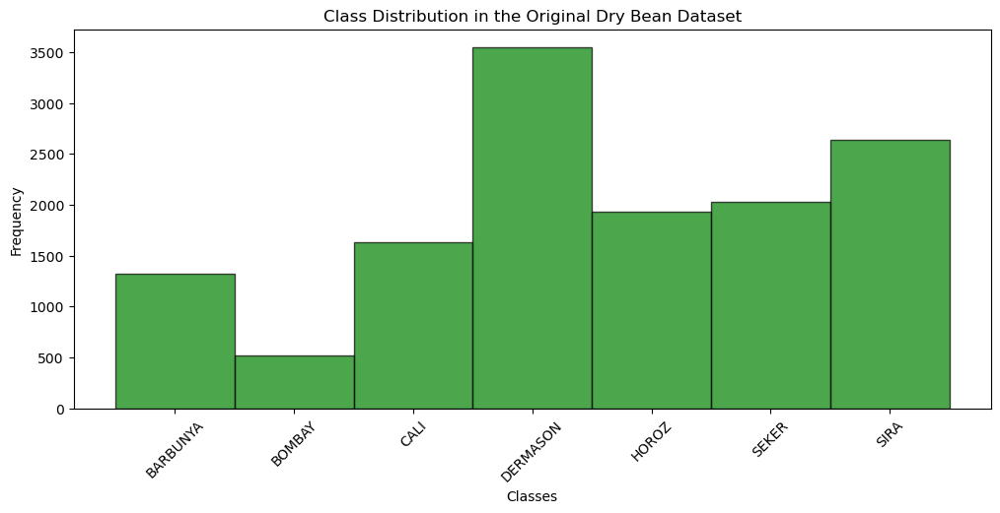

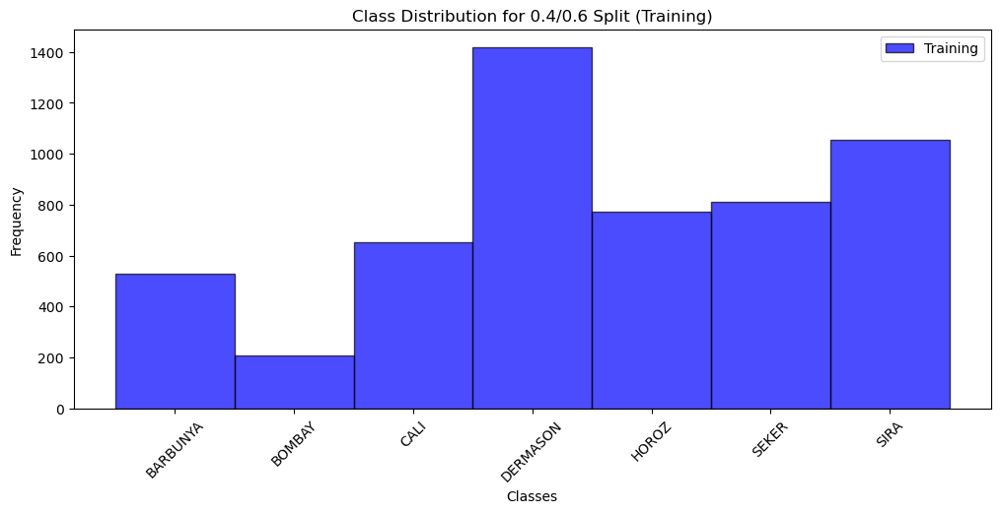

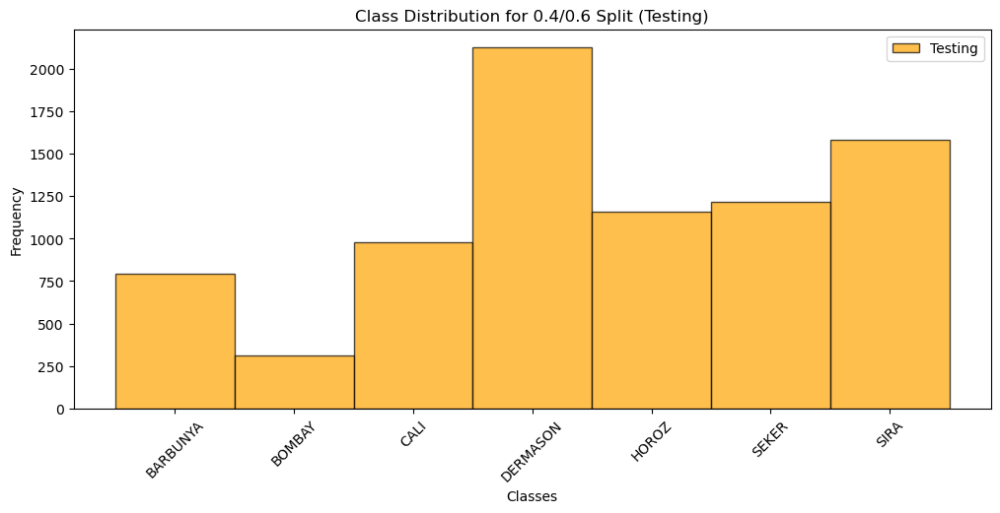

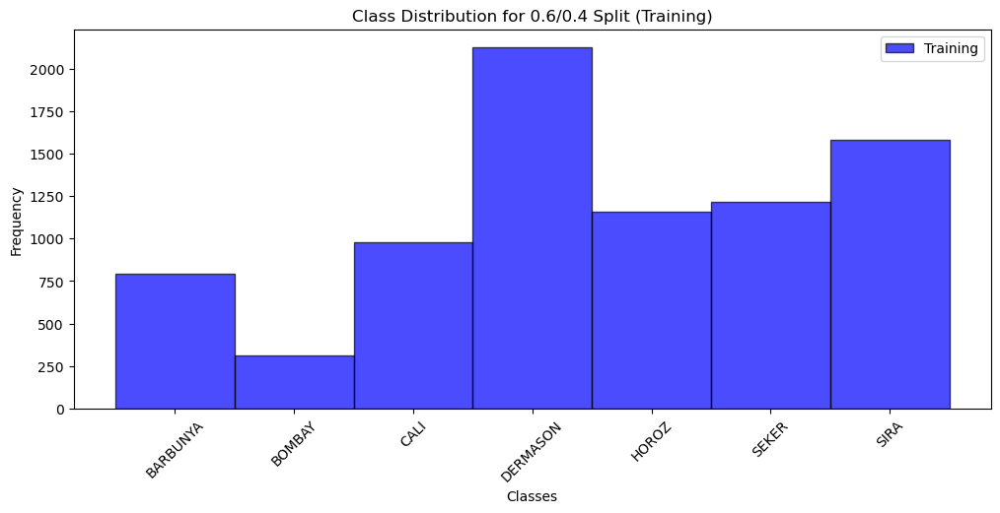

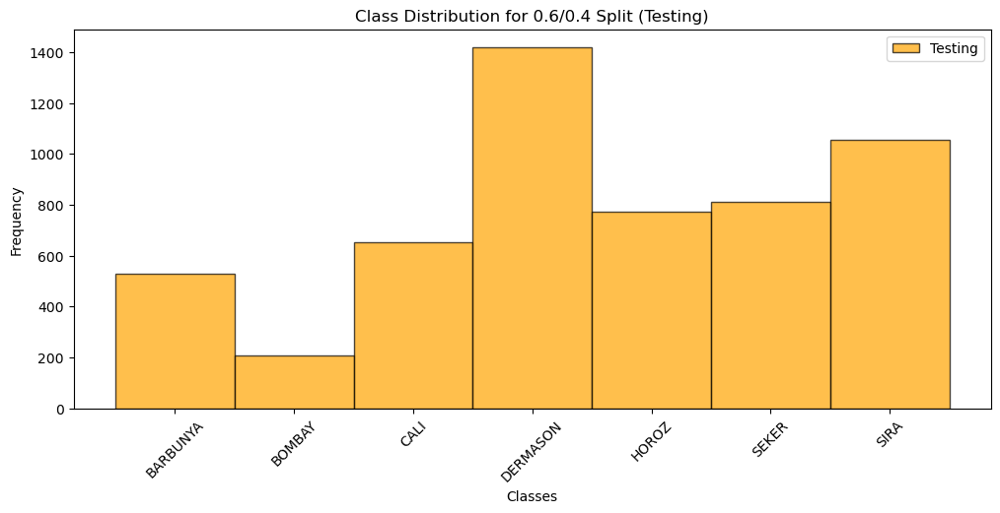

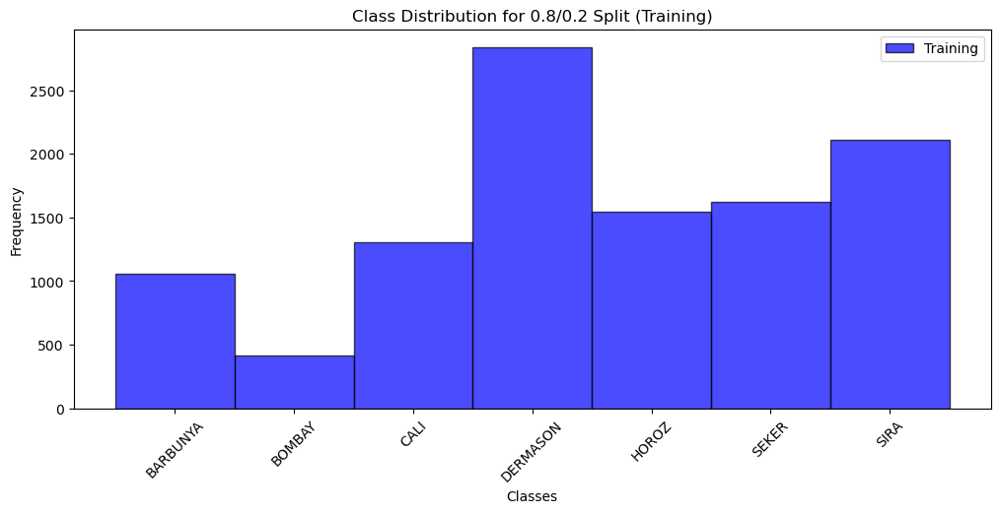

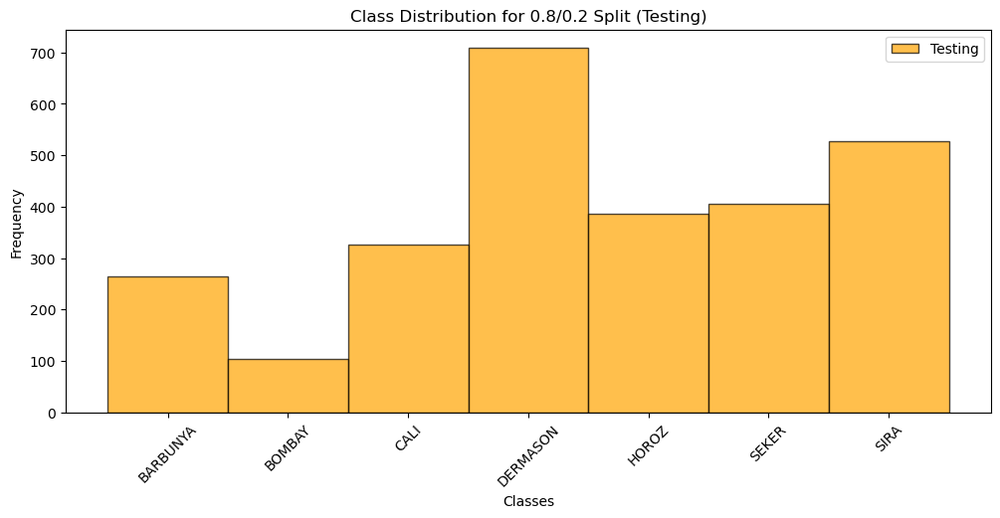

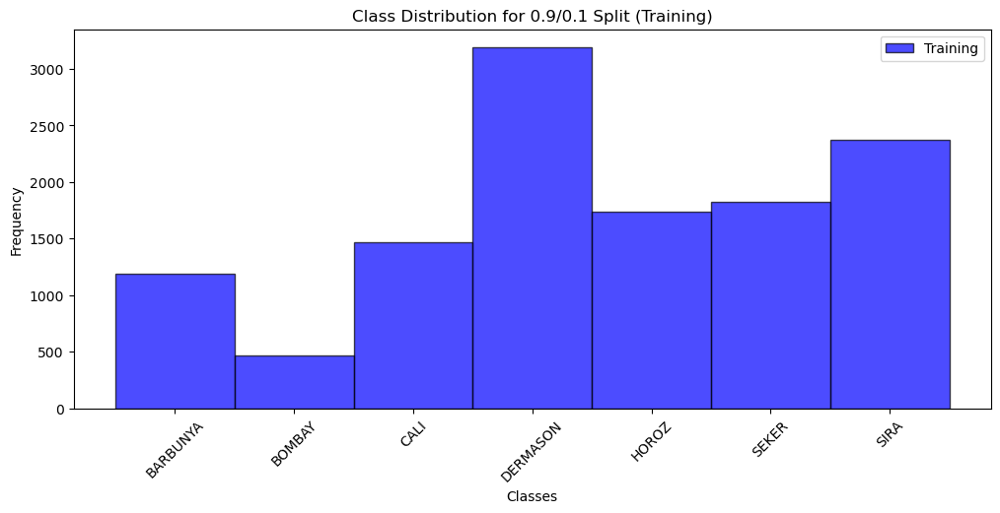

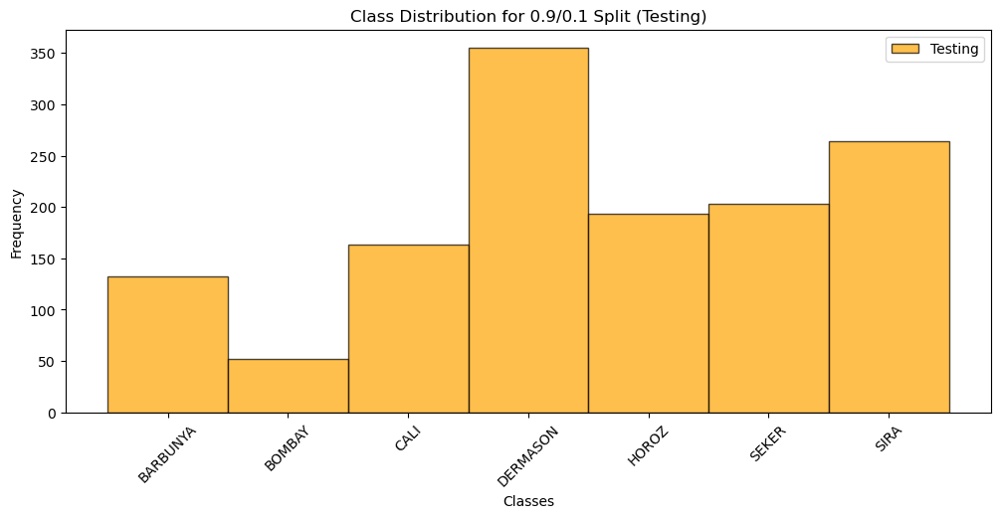

In [3]:
# Visualize the class distribution in the original Dry Bean dataset
plt.figure(figsize=(12, 5))
bins = np.arange(len(np.unique(labels_encoded)) + 1) - 0.5  # Center bins for discrete labels
plt.hist(labels_encoded, bins=bins, color="green", alpha=0.7, edgecolor="black")
plt.title("Class Distribution in the Original Dry Bean Dataset")
plt.xlabel("Classes")
plt.ylabel("Frequency")
plt.xticks(np.arange(len(class_names)), class_names, rotation=45)
plt.show()

# Visualize distributions for each train/test split
for i in range(len(subsets)):
    label_train = subsets[i]['label_train']
    label_test = subsets[i]['label_test']

    bins = np.arange(len(np.unique(labels_encoded)) + 1) - 0.5  # Center bins for consistent alignment
    
    plt.figure(figsize=(12, 5))
    plt.hist(label_train, bins=bins, color="blue", alpha=0.7, edgecolor="black", label="Training")
    plt.title(f"Class Distribution for {split_ratios[i][0]}/{split_ratios[i][1]} Split (Training)")
    plt.xlabel("Classes")
    plt.ylabel("Frequency")
    plt.xticks(np.arange(len(class_names)), class_names, rotation=45)
    plt.legend()
    plt.show()
    
    plt.figure(figsize=(12, 5))
    plt.hist(label_test, bins=bins, color="orange", alpha=0.7, edgecolor="black", label="Testing")
    plt.title(f"Class Distribution for {split_ratios[i][0]}/{split_ratios[i][1]} Split (Testing)")
    plt.xlabel("Classes")
    plt.ylabel("Frequency")
    plt.xticks(np.arange(len(class_names)), class_names, rotation=45)
    plt.legend()
    plt.show()

## 2. Xây dựng Decision Tree

### 2.1. Train model

In [4]:
# Train and evaluate the Decision Tree model using Entropy (Information Gain) for Dry Bean
models = []
for i, subset in enumerate(subsets):
    feature_train = subset['feature_train']
    label_train = subset['label_train']
    model = DecisionTreeClassifier(criterion='entropy', random_state=42, class_weight='balanced')
    model.fit(feature_train, label_train)
    models.append(model)

### 2.2. Visualization

Decision tree of the model trained with split ratio 0.4/0.6



(process:26536): Pango-CRITICAL **: 19:46:50.945: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:26536): Pango-CRITICAL **: 19:46:50.946: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:26536): Pango-CRITICAL **: 19:46:50.946: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:26536): Pango-CRITICAL **: 19:46:50.946: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.77704 to fit


Decision tree of the model trained with split ratio 0.6/0.4



(process:5636): Pango-CRITICAL **: 19:46:59.695: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:5636): Pango-CRITICAL **: 19:46:59.695: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:5636): Pango-CRITICAL **: 19:46:59.695: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:5636): Pango-CRITICAL **: 19:46:59.695: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.445731 to fit


Decision tree of the model trained with split ratio 0.8/0.2



(process:27980): Pango-CRITICAL **: 19:47:03.913: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:27980): Pango-CRITICAL **: 19:47:03.913: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:27980): Pango-CRITICAL **: 19:47:03.913: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:27980): Pango-CRITICAL **: 19:47:03.913: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.317344 to fit


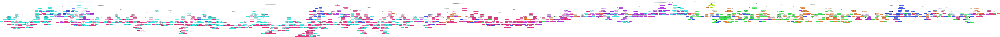

Decision tree of the model trained with split ratio 0.9/0.1



(process:14828): Pango-CRITICAL **: 19:47:06.472: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:14828): Pango-CRITICAL **: 19:47:06.472: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:14828): Pango-CRITICAL **: 19:47:06.472: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:14828): Pango-CRITICAL **: 19:47:06.472: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.29907 to fit


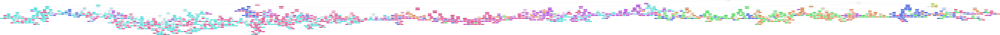

In [5]:
for i in range(len(models)):
    print(f"Decision tree of the model trained with split ratio {split_ratios[i][0]}/{split_ratios[i][1]}")
    # Export the decision tree to DOT format
    dot_data = export_graphviz(
        models[i],
        out_file=None,
        feature_names=feature_columns,
        class_names=class_names,
        filled=True,
        rounded=True,
        special_characters=True,
        fontname="Arial"
    )
    
    # Render the DOT file with Graphviz
    graph = Source(dot_data)
    # Visualize the tree
    graph.render(f"./tree/tree2/tree_{split_ratios[i][0]}_{split_ratios[i][1]}", 
                 format='png', 
                 cleanup=True)
    display(Image(filename=f"./tree/tree2/tree_{split_ratios[i][0]}_{split_ratios[i][1]}.png"))

## 3. Đánh giá Decision Tree
### 3.1. Classification report & confusion matrix


Split (0.4, 0.6) Class Distribution in Test Set:
BARBUNYA     793
BOMBAY       313
CALI         978
DERMASON    2128
HOROZ       1157
SEKER       1216
SIRA        1582
Name: count, dtype: int64
Classification Report for 0.4/0.6 Split:
              precision    recall  f1-score   support

    BARBUNYA       0.89      0.90      0.89       793
      BOMBAY       1.00      1.00      1.00       313
        CALI       0.90      0.91      0.90       978
    DERMASON       0.89      0.88      0.88      2128
       HOROZ       0.94      0.93      0.93      1157
       SEKER       0.93      0.93      0.93      1216
        SIRA       0.81      0.82      0.81      1582

    accuracy                           0.89      8167
   macro avg       0.91      0.91      0.91      8167
weighted avg       0.89      0.89      0.89      8167



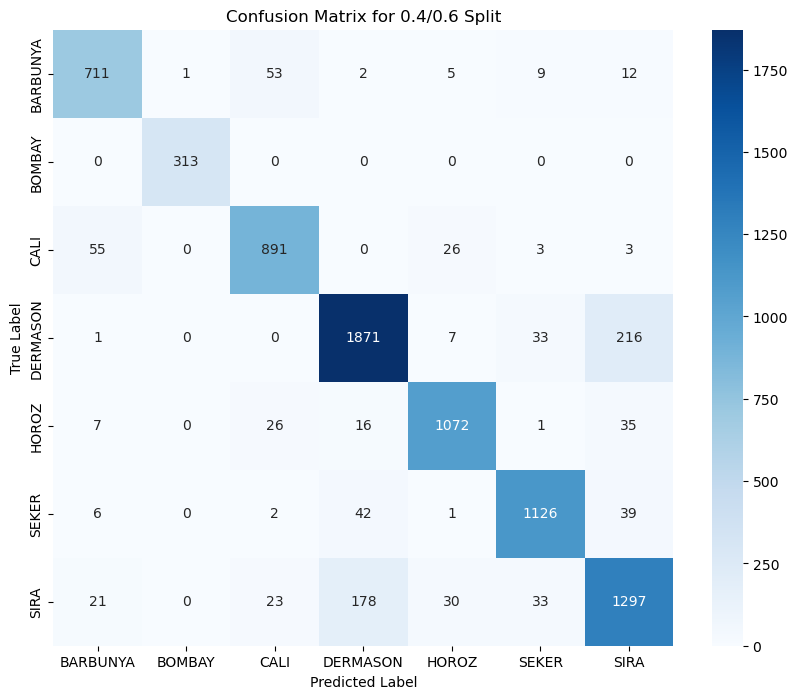

Split (0.6, 0.4) Class Distribution in Test Set:
BARBUNYA     529
BOMBAY       209
CALI         652
DERMASON    1419
HOROZ        771
SEKER        811
SIRA        1054
Name: count, dtype: int64
Classification Report for 0.6/0.4 Split:
              precision    recall  f1-score   support

    BARBUNYA       0.90      0.90      0.90       529
      BOMBAY       1.00      1.00      1.00       209
        CALI       0.92      0.93      0.92       652
    DERMASON       0.89      0.89      0.89      1419
       HOROZ       0.94      0.94      0.94       771
       SEKER       0.92      0.93      0.92       811
        SIRA       0.83      0.82      0.82      1054

    accuracy                           0.90      5445
   macro avg       0.91      0.92      0.91      5445
weighted avg       0.90      0.90      0.90      5445



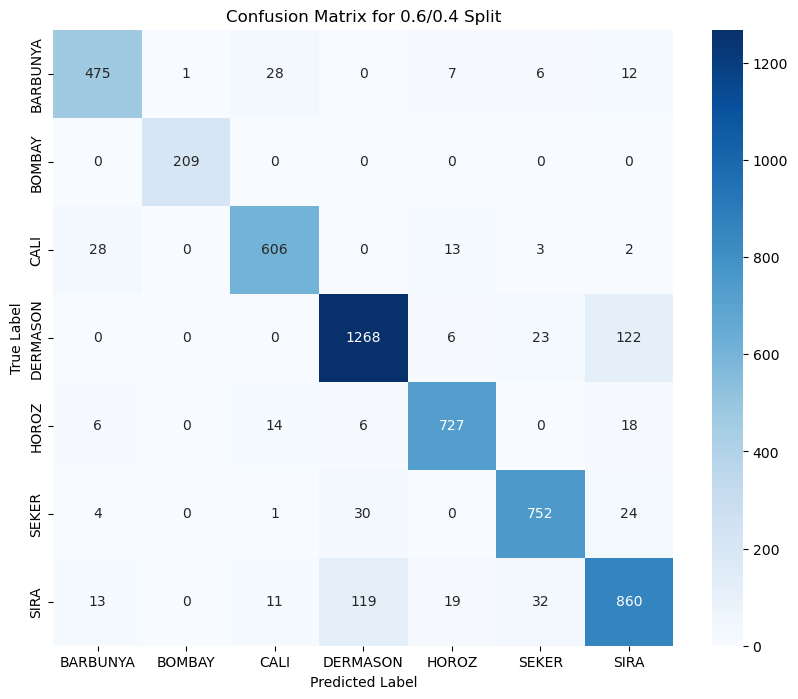

Split (0.8, 0.2) Class Distribution in Test Set:
BARBUNYA    265
BOMBAY      104
CALI        326
DERMASON    709
HOROZ       386
SEKER       406
SIRA        527
Name: count, dtype: int64
Classification Report for 0.8/0.2 Split:
              precision    recall  f1-score   support

    BARBUNYA       0.87      0.87      0.87       265
      BOMBAY       1.00      1.00      1.00       104
        CALI       0.91      0.90      0.91       326
    DERMASON       0.89      0.90      0.90       709
       HOROZ       0.95      0.94      0.94       386
       SEKER       0.91      0.94      0.93       406
        SIRA       0.83      0.81      0.82       527

    accuracy                           0.89      2723
   macro avg       0.91      0.91      0.91      2723
weighted avg       0.89      0.89      0.89      2723



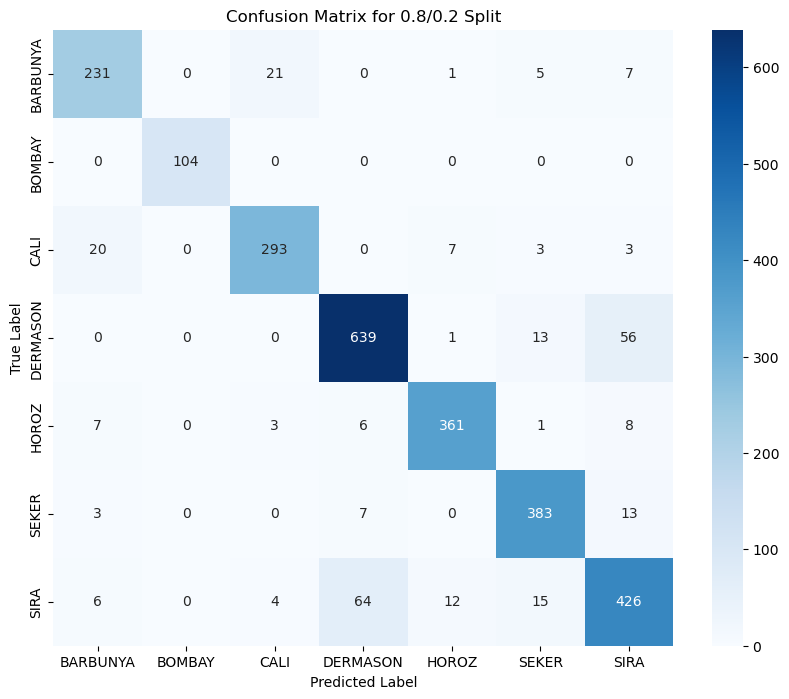

Split (0.9, 0.1) Class Distribution in Test Set:
BARBUNYA    132
BOMBAY       52
CALI        163
DERMASON    355
HOROZ       193
SEKER       203
SIRA        264
Name: count, dtype: int64
Classification Report for 0.9/0.1 Split:
              precision    recall  f1-score   support

    BARBUNYA       0.84      0.86      0.85       132
      BOMBAY       1.00      1.00      1.00        52
        CALI       0.91      0.87      0.89       163
    DERMASON       0.89      0.88      0.88       355
       HOROZ       0.92      0.95      0.93       193
       SEKER       0.90      0.95      0.92       203
        SIRA       0.79      0.76      0.78       264

    accuracy                           0.88      1362
   macro avg       0.89      0.90      0.89      1362
weighted avg       0.88      0.88      0.88      1362



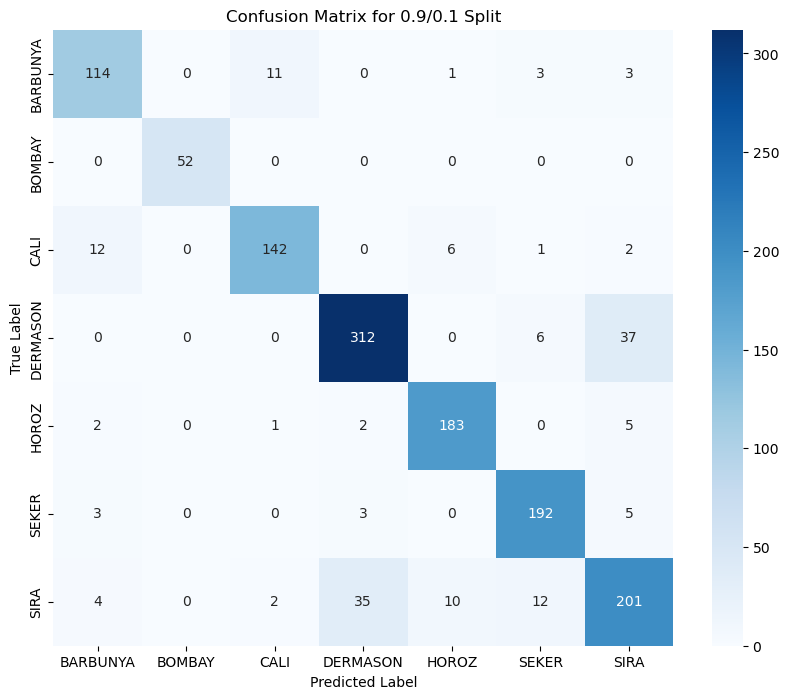

In [6]:
# For each model and split, make predictions, generate a report, and confusion matrix for Dry Bean
for i, subset in enumerate(subsets):
    feature_train = subset['feature_train']
    label_train = subset['label_train']
    feature_test = subset['feature_test']
    label_test = subset['label_test']
    
    # Make predictions
    label_pred = models[i].predict(feature_test)
    
    # Print class distribution in test set
    print(f"Split {split_ratios[i]} Class Distribution in Test Set:")
    print(pd.Series(label_test).value_counts().sort_index().rename(index=dict(enumerate(class_names))))
    
    # Generate classification report
    print(f"Classification Report for {split_ratios[i][0]}/{split_ratios[i][1]} Split:")
    print(classification_report(label_test, label_pred, target_names=class_names, zero_division=0))
    
    # Generate confusion matrix
    cm = confusion_matrix(label_test, label_pred)
    
    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Confusion Matrix for {split_ratios[i][0]}/{split_ratios[i][1]} Split")
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

### 3.2. Insights

#### 3.2.1. Tỷ lệ 40/60

- Độ chính xác: 89% trên 8167 mẫu kiểm tra.
- F1-score trung bình (macro): 0.91.
- Các lớp BARBUNYA, CALI, DERMASON, HOROZ, SEKER đều có - f1-score từ 0.88 trở lên.
- Lớp BOMBAY đạt f1-score tuyệt đối (1.00).
- Lớp SIRA có f1-score thấp nhất (0.81) nhưng vẫn ở mức khá.
- Mô hình nhận diện tốt tất cả các lớp, không có dấu hiệu mất cân bằng nghiêm trọng.

#### 3.2.2. Tỷ lệ 60/40

- Độ chính xác: 90% trên 5445 mẫu kiểm tra.
- F1-score trung bình (macro): 0.91.
- Các lớp BARBUNYA, CALI, HOROZ, SEKER đều có f1-score từ 0.90 trở lên.
- Lớp BOMBAY tiếp tục đạt f1-score tuyệt đối (1.00).
- DERMASON có f1-score 0.89, SIRA thấp nhất với 0.82 nhưng vẫn ổn định.
- Mô hình nhận diện tốt tất cả các lớp, hiệu suất đồng đều, không có dấu hiệu mất cân bằng nghiêm trọng.

#### 3.2.3. Tỷ lệ 80/20

- Độ chính xác: 89% trên 2723 mẫu kiểm tra.
- F1-score trung bình (macro): 0.91.
- Các lớp BARBUNYA, CALI, DERMASON, HOROZ, SEKER đều có - f1-score từ 0.87 trở lên.
- Lớp BOMBAY tiếp tục đạt f1-score tuyệt đối (1.00).
- Lớp SIRA có f1-score thấp nhất (0.82) nhưng vẫn ổn định.
- Mô hình duy trì hiệu suất tốt trên tất cả các lớp, không có dấu hiệu mất cân bằng nghiêm trọng.

#### 3.2.4. Tỷ lệ 90/10

- Độ chính xác: 88% trên 1362 mẫu kiểm tra.
- F1-score trung bình (macro): 0.89.
- Các lớp BARBUNYA, CALI, DERMASON, HOROZ, SEKER đều có - f1-score từ 0.85 trở lên.
- Lớp BOMBAY tiếp tục đạt f1-score tuyệt đối (1.00).
- Lớp SIRA có f1-score thấp nhất (0.78), giảm nhẹ so với các tỷ lệ khác.
- Mô hình vẫn nhận diện tốt các lớp, tuy nhiên hiệu suất có xu hướng giảm nhẹ ở các lớp nhỏ khi tập kiểm tra nhỏ hơn.

### 3.3. Kết luận chung

- Mô hình Decision Tree đạt hiệu suất cao và ổn định trên tập dữ liệu Dry Bean ở tất cả các tỷ lệ chia train/test.
- Độ chính xác dao động từ 88% đến 90%, f1-score trung bình (macro) luôn trên 0.89.
- Các lớp lớn và nhỏ đều được nhận diện tốt, lớp BOMBAY luôn đạt f1-score tuyệt đối (1.00).
- Lớp SIRA có f1-score thấp nhất nhưng vẫn ở mức khá, hiệu suất giảm nhẹ khi tập kiểm tra nhỏ hơn.
- Không có dấu hiệu mất cân bằng nghiêm trọng, mô hình hoạt động đồng đều giữa các lớp.
- Tỷ lệ 40/60 và 60/40 cho hiệu quả cao và ổn định nhất, tỷ lệ 90/10 có thể gây giảm nhẹ hiệu suất ở các lớp nhỏ.

## 4. Độ sâu (depth) và độ chính xác (accuracy) của Decision Tree

### 4.1 Visualization

Decision tree of the model trained with split ratio 80/20 and max depth None



(process:6668): Pango-CRITICAL **: 19:47:10.752: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:6668): Pango-CRITICAL **: 19:47:10.752: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:6668): Pango-CRITICAL **: 19:47:10.753: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:6668): Pango-CRITICAL **: 19:47:10.753: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.317344 to fit


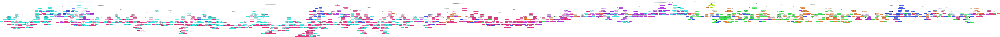

Accuracy for max_depth None: 0.8950
Decision tree of the model trained with split ratio 80/20 and max depth 2



(process:5008): Pango-CRITICAL **: 19:47:13.250: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:5008): Pango-CRITICAL **: 19:47:13.250: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:5008): Pango-CRITICAL **: 19:47:13.250: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:5008): Pango-CRITICAL **: 19:47:13.250: pango_font_description_get_family: assertion 'desc != NULL' failed


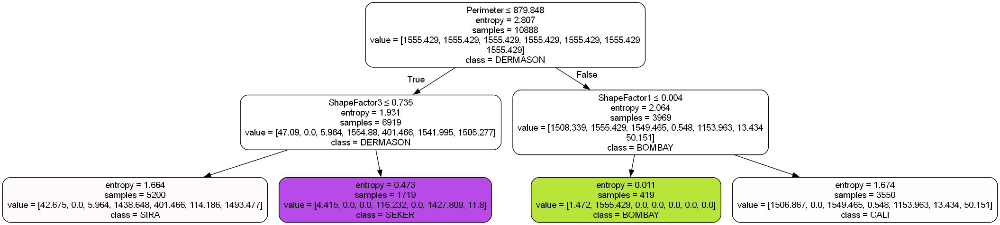

Accuracy for max_depth 2: 0.4793
Decision tree of the model trained with split ratio 80/20 and max depth 3



(process:23984): Pango-CRITICAL **: 19:47:14.092: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:23984): Pango-CRITICAL **: 19:47:14.092: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:23984): Pango-CRITICAL **: 19:47:14.093: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:23984): Pango-CRITICAL **: 19:47:14.093: pango_font_description_get_family: assertion 'desc != NULL' failed


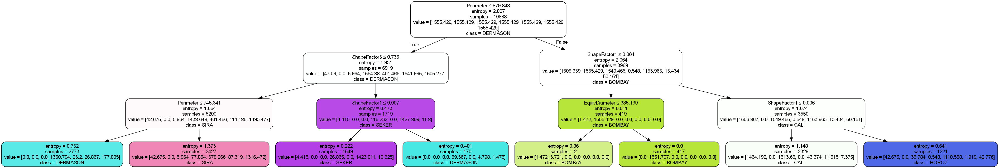

Accuracy for max_depth 3: 0.7984
Decision tree of the model trained with split ratio 80/20 and max depth 4



(process:33148): Pango-CRITICAL **: 19:47:14.887: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:33148): Pango-CRITICAL **: 19:47:14.887: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:33148): Pango-CRITICAL **: 19:47:14.887: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:33148): Pango-CRITICAL **: 19:47:14.887: pango_font_description_get_family: assertion 'desc != NULL' failed


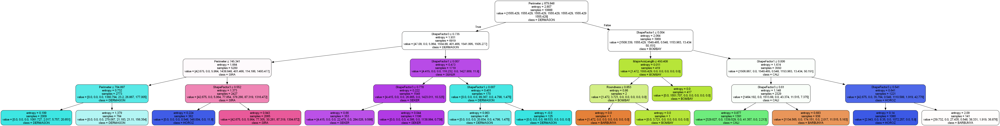

Accuracy for max_depth 4: 0.8784
Decision tree of the model trained with split ratio 80/20 and max depth 5



(process:12044): Pango-CRITICAL **: 19:47:15.821: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:12044): Pango-CRITICAL **: 19:47:15.821: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:12044): Pango-CRITICAL **: 19:47:15.821: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:12044): Pango-CRITICAL **: 19:47:15.821: pango_font_description_get_family: assertion 'desc != NULL' failed


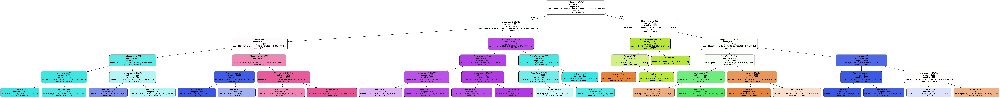

Accuracy for max_depth 5: 0.8895
Decision tree of the model trained with split ratio 80/20 and max depth 6



(process:15024): Pango-CRITICAL **: 19:47:17.051: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:15024): Pango-CRITICAL **: 19:47:17.051: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:15024): Pango-CRITICAL **: 19:47:17.051: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:15024): Pango-CRITICAL **: 19:47:17.051: pango_font_description_get_family: assertion 'desc != NULL' failed


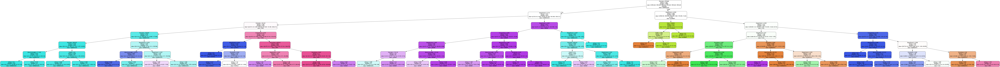

Accuracy for max_depth 6: 0.8990
Decision tree of the model trained with split ratio 80/20 and max depth 7



(process:25324): Pango-CRITICAL **: 19:47:18.505: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:25324): Pango-CRITICAL **: 19:47:18.505: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:25324): Pango-CRITICAL **: 19:47:18.505: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:25324): Pango-CRITICAL **: 19:47:18.505: pango_font_description_get_family: assertion 'desc != NULL' failed


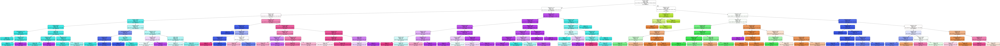

Accuracy for max_depth 7: 0.9060


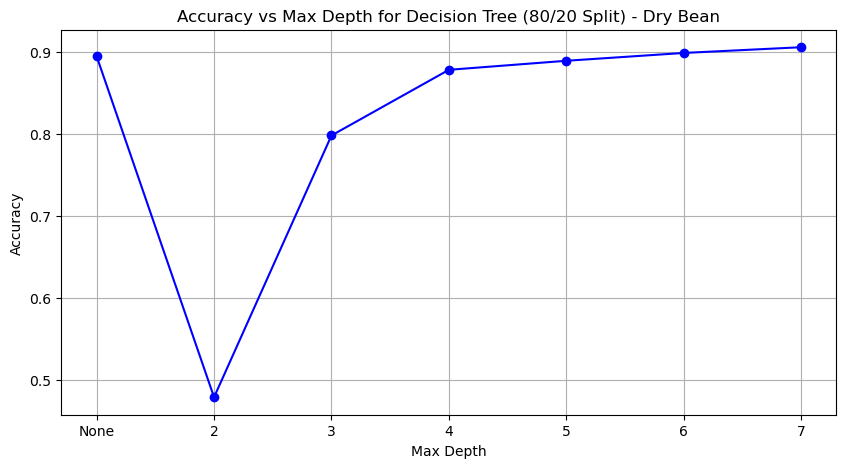

In [7]:
# Chọn tỷ lệ 80/20 (index 2 trong split_ratios)
subset_80_20 = subsets[2]
feature_train_80_20 = subset_80_20['feature_train']
label_train_80_20 = subset_80_20['label_train']
feature_test_80_20 = subset_80_20['feature_test']
label_test_80_20 = subset_80_20['label_test']

accuracy_scores = []
depths = [None, 2, 3, 4, 5, 6, 7]

for depth in depths:
    model = DecisionTreeClassifier(criterion='entropy', random_state=42, max_depth=depth, class_weight='balanced')
    model.fit(feature_train_80_20, label_train_80_20)

    print(f"Decision tree of the model trained with split ratio 80/20 and max depth {depth}")
    # Export the decision tree to DOT format
    dot_data = export_graphviz(
        model,
        out_file=None,
        feature_names=feature_columns,
        class_names=class_names,
        filled=True,
        rounded=True,
        special_characters=True,
        fontname="Arial"
    )
    
    # Render the DOT file with Graphviz
    graph = Source(dot_data)
    # Visualize the tree
    graph.render(f"./tree_80_20/tree2/tree_{depth}", 
                 format='png', 
                 cleanup=True)
    display(Image(filename=f"./tree_80_20/tree2/tree_{depth}.png"))

    # Make predictions and calculate accuracy
    pred = model.predict(feature_test_80_20)
    accuracy = accuracy_score(label_test_80_20, pred)
    print(f"Accuracy for max_depth {depth}: {accuracy:.4f}")
    accuracy_scores.append(accuracy)

# Plot the results
depths_for_plot = [str(d) if d is not None else 'None' for d in depths]
plt.figure(figsize=(10, 5))
plt.plot(depths_for_plot, accuracy_scores, marker='o', linestyle='-', color='blue')
plt.title('Accuracy vs Max Depth for Decision Tree (80/20 Split) - Dry Bean')
plt.xlabel('Max Depth')
plt.ylabel('Accuracy')
plt.xticks(depths_for_plot)
plt.grid(True)
plt.show()

### 4.2. Insights

|max_depth|None   |2      |3      |4      |5      |6      |7      |
|---------|-------|-------|-------|-------|-------|-------|-------|
|Accuracy|0.8950 |0.4793 |0.7984 |0.8784 |0.8895 |0.8990 |0.9060 |


- Khi không giới hạn độ sâu (max_depth = None), mô hình đạt độ chính xác khá cao (0.8950).
- Khi giới hạn độ sâu ở mức 2, độ chính xác giảm mạnh xuống còn 0.4793; ở mức 3, accuracy tăng lên 0.7984 nhưng vẫn thấp hơn so với các độ sâu lớn hơn.
- Từ độ sâu 4 trở đi, độ chính xác tăng dần và đạt tối đa ở mức 7 (0.9060), cho thấy mô hình càng sâu càng phân biệt tốt các lớp trong tập dữ liệu Dry Bean.